In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.pyplot import figure
# from google.colab import drive
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.preprocessing import OrdinalEncoder
from sklearn.model_selection import KFold, train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import plot_confusion_matrix, confusion_matrix, classification_report
from sklearn import tree
%matplotlib inline
# drive.mount('/content/drive')
mpl.style.use('bmh')


#### Colores

Lisstado de colores para presentar en la información


In [2]:
class Colores:
    RED = '\033[91m'
    GREEN = '\033[92m'
    YELLOW = '\033[93m'
    BLUE = '\033[94m'
    PINK = '\033[95m'
    TEAL = '\033[96m'
    GREY = '\033[97m'
    ENDC = '\033[0m'


# **Lectura de archivos**


In [3]:
# **Read File Credit_Record**
pd_credit_record_initial = pd.read_csv(
    "../DataSet/Tarjeta_Credito/credit_record.csv")
pd_credit_record_initial.head()


,ID,MONTHS_BALANCE,STATUS
0,5001711,0,X
1,5001711,-1,0
2,5001711,-2,0
3,5001711,-3,0
4,5001712,0,C


In [4]:
# Read File Application
pd_application_record_initial = pd.read_csv(
    "../DataSet/Tarjeta_Credito/application_record.csv")
pd_application_record_initial.head()


,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
1,5008805,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
2,5008806,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,1,0,0,0,Security staff,2.0
3,5008808,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0
4,5008809,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0


# **Exploracion datasets**


## Credit card record


In [5]:
pd_credit_record_initial.shape


(1048575, 3)

In [6]:
pd_credit_record_initial.describe()


,ID,MONTHS_BALANCE
count,1.048575e+06,1.048575e+06
mean,5.068286e+06,-1.913700e+01
std,4.615058e+04,1.402350e+01
min,5.001711e+06,-6.000000e+01
25%,5.023644e+06,-2.900000e+01
50%,5.062104e+06,-1.700000e+01
75%,5.113856e+06,-7.000000e+00
max,5.150487e+06,0.000000e+00


In [93]:
pd_credit_record_initial.dtypes


ID                 int64
MONTHS_BALANCE     int64
STATUS            object
dtype: object

In [94]:
pd_credit_record_initial.isnull().sum()


ID                0
MONTHS_BALANCE    0
STATUS            0
dtype: int64

In [95]:
%pip install "https://github.com/pandas-profiling/pandas-profiling/archive/master.zip"


  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [96]:
%pip install ipywidgets


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [97]:
from pandas_profiling import ProfileReport
ProfileReport(pd_credit_record_initial, minimal=True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Application record


In [98]:
pd_application_record_initial.shape


(438557, 18)

In [99]:
pd_application_record_initial.describe()


,ID,CNT_CHILDREN,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS
count,4.385570e+05,438557.000000,4.385570e+05,438557.000000,438557.000000,438557.0,438557.000000,438557.000000,438557.000000,438557.000000
mean,6.022176e+06,0.427390,1.875243e+05,-15997.904649,60563.675328,1.0,0.206133,0.287771,0.108207,2.194465
std,5.716370e+05,0.724882,1.100869e+05,4185.030007,138767.799647,0.0,0.404527,0.452724,0.310642,0.897207
min,5.008804e+06,0.000000,2.610000e+04,-25201.000000,-17531.000000,1.0,0.000000,0.000000,0.000000,1.000000
25%,5.609375e+06,0.000000,1.215000e+05,-19483.000000,-3103.000000,1.0,0.000000,0.000000,0.000000,2.000000
50%,6.047745e+06,0.000000,1.607805e+05,-15630.000000,-1467.000000,1.0,0.000000,0.000000,0.000000,2.000000
75%,6.456971e+06,1.000000,2.250000e+05,-12514.000000,-371.000000,1.0,0.000000,1.000000,0.000000,3.000000
max,7.999952e+06,19.000000,6.750000e+06,-7489.000000,365243.000000,1.0,1.000000,1.000000,1.000000,20.000000


In [100]:
pd_application_record_initial.dtypes


ID                       int64
CODE_GENDER             object
FLAG_OWN_CAR            object
FLAG_OWN_REALTY         object
CNT_CHILDREN             int64
AMT_INCOME_TOTAL       float64
NAME_INCOME_TYPE        object
NAME_EDUCATION_TYPE     object
NAME_FAMILY_STATUS      object
NAME_HOUSING_TYPE       object
DAYS_BIRTH               int64
DAYS_EMPLOYED            int64
FLAG_MOBIL               int64
FLAG_WORK_PHONE          int64
FLAG_PHONE               int64
FLAG_EMAIL               int64
OCCUPATION_TYPE         object
CNT_FAM_MEMBERS        float64
dtype: object

In [101]:
pd_application_record_initial.isnull().sum()


ID                          0
CODE_GENDER                 0
FLAG_OWN_CAR                0
FLAG_OWN_REALTY             0
CNT_CHILDREN                0
AMT_INCOME_TOTAL            0
NAME_INCOME_TYPE            0
NAME_EDUCATION_TYPE         0
NAME_FAMILY_STATUS          0
NAME_HOUSING_TYPE           0
DAYS_BIRTH                  0
DAYS_EMPLOYED               0
FLAG_MOBIL                  0
FLAG_WORK_PHONE             0
FLAG_PHONE                  0
FLAG_EMAIL                  0
OCCUPATION_TYPE        134203
CNT_FAM_MEMBERS             0
dtype: int64

In [102]:
! pip install "https://github.com/pandas-profiling/pandas-profiling/archive/master.zip"


  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached scipy-1.9.3-cp311-cp311-win_amd64.whl (39.9 MB)
  Using cached pandas-1.5.2-cp311-cp311-win_amd64.whl (10.3 MB)
  Using cached matplotlib-3.6.3-cp311-cp311-win_amd64.whl (7.2 MB)
  Using cached pydantic-1.10.4-cp311-cp311-win_amd64.whl (2.1 MB)
  Using cached PyYAML-6.0-cp311-cp311-win_amd64.whl (143 kB)
  Using cached Jinja2-3.1.2-py3-none-any.whl (133 kB)
  Using cached visions-0.7.5-py3-none-any.whl (102 kB)
  Using cached numpy-1.23.5-cp311-cp311-win_amd64.whl (14.6 MB)
  Using cached htmlmin-0.1.12.tar.gz (19 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached phik-0.12.3-cp311-cp311-win_amd64.whl (663 kB)
  Using cached requests-2.28.2-py3-none-any.whl (62 kB)
  Using cached tqdm-4.64.1-py2.py3-none-any.whl (78 

ERROR: Package 'pandas-profiling' requires a different Python: 3.11.0 not in '<3.11,>=3.7'

[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: C:\Python311\python.exe -m pip install --upgrade pip


In [7]:
from pandas_profiling import ProfileReport
ProfileReport(pd_application_record_initial, minimal=True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# **Limpieza de datos**


In [10]:
pd_credit_record = pd_credit_record_initial.drop_duplicates(subset=['ID'])
pd_application_record = pd_application_record_initial.drop_duplicates(subset=[
                                                                      'ID'])
print(pd_credit_record.shape)
print(pd_application_record.shape)


(45985, 3)
(438510, 18)


## Merge data


In [11]:
merge_record = pd.merge(pd_credit_record, pd_application_record, on=["ID"])
#merge_record.sort_values("ID", inplace=True)
merge_record['DAYS_BIRTH'] = merge_record['DAYS_BIRTH']/-365
merge_record.rename(columns={'DAYS_BIRTH': "AGE"}, inplace=True)

merge_record['DAYS_EMPLOYED'] = merge_record['DAYS_EMPLOYED']/-365
merge_record.rename(columns={'DAYS_EMPLOYED': "YEARS_EMPLOYED"}, inplace=True)

merge_record.head()


,ID,MONTHS_BALANCE,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5008804,0,C,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,32.890411,12.443836,1,1,0,0,NaN,2.0
1,5008805,0,C,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,32.890411,12.443836,1,1,0,0,NaN,2.0
2,5008806,0,C,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,58.832877,3.106849,1,0,0,0,Security staff,2.0
3,5008808,0,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1.0
4,5008809,-22,X,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52.356164,8.358904,1,0,1,1,Sales staff,1.0


In [12]:
merge_record.groupby(["STATUS"])["STATUS"].count()


STATUS
0     8456
1      276
2       19
3        6
4        5
5       76
C    17950
X     9669
Name: STATUS, dtype: int64

In [13]:
def status(s):
    if s == "C" or s == "X":
        return 0  # si aprueba tarjeta credito
    else:
        return 1  # no se aprueba tarjeta credito


merge_record['STATUS'] = merge_record['STATUS'].apply(lambda x: status(x))
merge_record = merge_record.astype({"CNT_FAM_MEMBERS": "int"})


In [17]:
relacion = merge_record.groupby(["STATUS"])["STATUS"].count()
print(relacion)

STATUS
0    27619
1     8838
Name: STATUS, dtype: int64


## Relación entre etiqueta 0 y etiqueta 1


In [16]:

if relacion[0] > relacion[1]:
    print(
        f"{Colores.GREEN} Etiqueta 0 es mayor a 1  : {Colores.RED}{relacion[0]/relacion[1]} {Colores.ENDC}")
else:
    print(
        f"{Colores.BLUE} Etiqueta 1 es mayor a 0  : {Colores.RED}{relacion[1]/relacion[0]} {Colores.ENDC}")


 Etiqueta 0 es mayor a 1  : 3.1250282869427473 


In [110]:
merge_record.describe()


,ID,MONTHS_BALANCE,STATUS,CNT_CHILDREN,AMT_INCOME_TOTAL,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS
count,3.645700e+04,36457.000000,36457.000000,36457.000000,3.645700e+04,36457.000000,36457.000000,36457.0,36457.000000,36457.000000,36457.000000,36457.000000
mean,5.078227e+06,-5.831802,0.242423,0.430315,1.866857e+05,43.767598,-162.364207,1.0,0.225526,0.294813,0.089722,2.198453
std,4.187524e+04,11.326494,0.428554,0.742367,1.017892e+05,11.508356,377.126945,0.0,0.417934,0.455965,0.285787,0.911686
min,5.008804e+06,-60.000000,0.000000,0.000000,2.700000e+04,20.517808,-1000.665753,1.0,0.000000,0.000000,0.000000,1.000000
25%,5.042028e+06,-6.000000,0.000000,0.000000,1.215000e+05,34.142466,1.117808,1.0,0.000000,0.000000,0.000000,2.000000
50%,5.074614e+06,0.000000,0.000000,0.000000,1.575000e+05,42.638356,4.252055,1.0,0.000000,0.000000,0.000000,2.000000
75%,5.115396e+06,0.000000,0.000000,1.000000,2.250000e+05,53.254795,8.638356,1.0,0.000000,1.000000,0.000000,3.000000
max,5.150487e+06,0.000000,1.000000,19.000000,1.575000e+06,68.909589,43.049315,1.0,1.000000,1.000000,1.000000,20.000000


## ETL

In [18]:
merge_record["AGE"] = merge_record["AGE"].astype('int64')
merge_record["CNT_FAM_MEMBERS"] = merge_record["CNT_FAM_MEMBERS"].astype(
    'int64')
merge_record.head()

,ID,MONTHS_BALANCE,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5008804,0,0,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,32,12.443836,1,1,0,0,NaN,2
1,5008805,0,0,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,32,12.443836,1,1,0,0,NaN,2
2,5008806,0,0,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,58,3.106849,1,0,0,0,Security staff,2
3,5008808,0,1,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52,8.358904,1,0,1,1,Sales staff,1
4,5008809,-22,0,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,52,8.358904,1,0,1,1,Sales staff,1


In [51]:
merge_record.groupby(["NAME_EDUCATION_TYPE"])["NAME_EDUCATION_TYPE"].count()

NAME_EDUCATION_TYPE
Academic degree                     32
Higher education                  9864
Incomplete higher                 1410
Lower secondary                    374
Secondary / secondary special    24777
Name: NAME_EDUCATION_TYPE, dtype: int64

### Creación de variables sintéticas

In [19]:
merge_record.insert(2, "AMT_INCOME_TOTALxFamily member",
                    merge_record['AMT_INCOME_TOTAL']/merge_record["CNT_FAM_MEMBERS"], allow_duplicates=True)
merge_record.head()


,ID,MONTHS_BALANCE,AMT_INCOME_TOTALxFamily member,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,...,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5008804,0,213750.0,0,M,Y,Y,0,427500.0,Working,...,Civil marriage,Rented apartment,32,12.443836,1,1,0,0,NaN,2
1,5008805,0,213750.0,0,M,Y,Y,0,427500.0,Working,...,Civil marriage,Rented apartment,32,12.443836,1,1,0,0,NaN,2
2,5008806,0,56250.0,0,M,Y,Y,0,112500.0,Working,...,Married,House / apartment,58,3.106849,1,0,0,0,Security staff,2
3,5008808,0,270000.0,1,F,N,Y,0,270000.0,Commercial associate,...,Single / not married,House / apartment,52,8.358904,1,0,1,1,Sales staff,1
4,5008809,-22,270000.0,0,F,N,Y,0,270000.0,Commercial associate,...,Single / not married,House / apartment,52,8.358904,1,0,1,1,Sales staff,1


Variables sintéticas generadas:

- AGE.

- YEARS_EMPLOYED

- AMT_INCOME_TOTAL x Family member


### **Reducción de la dimensionalidad del dataset**


#### Identificando Outliers


In [20]:
l = [x for x in merge_record.columns if x not in ["ID", "MONTHS_BALANCE", "STATUS", "CODE_GENDER", "FLAG_OWN_CAR",
                                                  "FLAG_OWN_REALTY", "DAYS_EMPLOYED", "NAME_INCOME_TYPE", "NAME_EDUCATION_TYPE",	"NAME_FAMILY_STATUS",
                                                  "NAME_HOUSING_TYPE", "FLAG_MOBIL", "FLAG_WORK_PHONE", "FLAG_PHONE", "FLAG_EMAIL", "OCCUPATION_TYPE",
                                                  "CNT_FAM_MEMBERS"]]
agg_merge_record = merge_record[l]
agg_merge_record


,AMT_INCOME_TOTALxFamily member,CNT_CHILDREN,AMT_INCOME_TOTAL,AGE,YEARS_EMPLOYED
0,213750.0,0,427500.0,32,12.443836
1,213750.0,0,427500.0,32,12.443836
2,56250.0,0,112500.0,58,3.106849
3,270000.0,0,270000.0,52,8.358904
4,270000.0,0,270000.0,52,8.358904
...,...,...,...,...,...
36452,52500.0,1,157500.0,29,4.764384
36453,52500.0,1,157500.0,29,4.764384
36454,52500.0,1,157500.0,29,4.764384
36455,52500.0,1,157500.0,29,4.764384


In [21]:
for i, j in zip(range(3), agg_merge_record.columns):
    fig = px.box(agg_merge_record.columns, x=agg_merge_record[j], title=str(
        agg_merge_record[j].name), height=400)
    fig.show()


In [22]:
def outliers(df, ft):
    Q1 = df[ft].quantile(0.25)
    Q3 = df[ft].quantile(0.75)
    IQR = Q3 - Q1

    frontera_inferior = Q1 - 1.5*IQR
    frontera_superior = Q3 + 1.5*IQR

    ls = df.index[(df[ft] < frontera_inferior) | (df[ft] > frontera_superior)]

    return ls


In [23]:
index_list = []
for column in ["AMT_INCOME_TOTAL", "AGE", "CNT_CHILDREN", "YEARS_EMPLOYED", "AMT_INCOME_TOTALxFamily member"]:
    index_list.extend(outliers(agg_merge_record, column))

print("Se identiticaron ", len(index_list), "Outliers")


Se identiticaron  11692 Outliers


#### Removiendo Outliers


In [24]:
def remover_outliers(df, ls):
    ls = sorted(set(ls))
    df = df.drop(ls)
    return df


In [25]:
merge_cleaned = remover_outliers(merge_record, index_list)
merge_cleaned


,ID,MONTHS_BALANCE,AMT_INCOME_TOTALxFamily member,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,...,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,5008806,0,56250.0,0,M,Y,Y,0,112500.0,Working,...,Married,House / apartment,58,3.106849,1,0,0,0,Security staff,2
10,5008815,0,135000.0,1,M,Y,Y,0,270000.0,Working,...,Married,House / apartment,46,2.106849,1,1,1,1,Accountants,2
11,5008819,-10,67500.0,0,M,Y,Y,0,135000.0,Commercial associate,...,Married,House / apartment,48,3.271233,1,0,0,0,Laborers,2
12,5008820,-8,67500.0,0,M,Y,Y,0,135000.0,Commercial associate,...,Married,House / apartment,48,3.271233,1,0,0,0,Laborers,2
13,5008821,0,67500.0,0,M,Y,Y,0,135000.0,Commercial associate,...,Married,House / apartment,48,3.271233,1,0,0,0,Laborers,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36452,5150482,-11,52500.0,0,F,Y,Y,1,157500.0,Working,...,Married,House / apartment,29,4.764384,1,0,0,0,Core staff,3
36453,5150483,0,52500.0,0,F,Y,Y,1,157500.0,Working,...,Married,House / apartment,29,4.764384,1,0,0,0,Core staff,3
36454,5150484,0,52500.0,0,F,Y,Y,1,157500.0,Working,...,Married,House / apartment,29,4.764384,1,0,0,0,Core staff,3
36455,5150485,0,52500.0,1,F,Y,Y,1,157500.0,Working,...,Married,House / apartment,29,4.764384,1,0,0,0,Core staff,3


In [26]:
l = [x for x in merge_cleaned.columns if x not in ["ID", "MONTHS_BALANCE",	"STATUS", "CODE_GENDER", "FLAG_OWN_CAR", "FLAG_OWN_REALTY", "DAYS_EMPLOYED", "NAME_INCOME_TYPE",
                                                   "NAME_EDUCATION_TYPE",	"NAME_FAMILY_STATUS",	"NAME_HOUSING_TYPE", "FLAG_MOBIL", "FLAG_WORK_PHONE", "FLAG_PHONE", "FLAG_EMAIL", "OCCUPATION_TYPE", "CNT_FAM_MEMBERS"]]
agg_merge_record_test = merge_cleaned[l]
agg_merge_record_test


,AMT_INCOME_TOTALxFamily member,CNT_CHILDREN,AMT_INCOME_TOTAL,AGE,YEARS_EMPLOYED
2,56250.0,0,112500.0,58,3.106849
10,135000.0,0,270000.0,46,2.106849
11,67500.0,0,135000.0,48,3.271233
12,67500.0,0,135000.0,48,3.271233
13,67500.0,0,135000.0,48,3.271233
...,...,...,...,...,...
36452,52500.0,1,157500.0,29,4.764384
36453,52500.0,1,157500.0,29,4.764384
36454,52500.0,1,157500.0,29,4.764384
36455,52500.0,1,157500.0,29,4.764384


In [27]:
# plt.figure(figsize=(13,11))
for i, j in zip(range(3), agg_merge_record_test):
    fig = px.box(agg_merge_record_test, x=agg_merge_record_test[j], title=str(
        agg_merge_record_test[j].name), height=400)
    fig.show()
    # plt.subplot(4,2,i+1)
    # sns.boxplot(x=agg_merge_record_test[j])
    # plt.title(j)
    # plt.xlabel('')


In [121]:
# merge_cleaned.drop(
#     ["MONTHS_BALANCE"], axis=1, inplace=True)
# merge_cleaned['STATUS'] = merge_cleaned['STATUS'].astype('int64')
# merge_cleaned.head()


### Normalizando

In [28]:
def changeNameEducation(e):
    if e == "Higher education":
        return 0
    elif e == "Secondary / secondary special":
        return 1
    elif e == 'Incomplete higher':
        return 2
    elif e == 'Lower secondary':
        return 3
    elif e == 'Academic degree':
        return 4
    else:
        return 5


def changeNameIncomeType(e):
    if e == "Working":
        return 0
    elif e == "Commercial associate":
        return 1
    elif e == 'Pensioner':
        return 2
    elif e == 'State servant':
        return 3
    else:
        return 4


def changFamilyStatus(e):
    if e == "Civil marriage":
        return 0
    elif e == "Married":
        return 1
    elif e == 'Single / not married':
        return 2
    elif e == 'Separated':
        return 3
    elif e == 'Widow':
        return 4
    else:
        return 5


def changHousingType(e):
    if e == "Rented apartment":
        return 0
    elif e == "House / apartment":
        return 1
    elif e == 'Municipal apartment':
        return 2
    elif e == 'With parents':
        return 3
    elif e == 'Co-op apartment':
        return 4
    elif e == 'Office apartment':
        return 5
    else:
        return 6


def changOccupationType(e):
    if e == "Security staff":
        return 0
    elif e == "Sales staff":
        return 1
    elif e == 'Accountants':
        return 2
    elif e == 'Laborers':
        return 3
    elif e == 'Managers':
        return 4
    elif e == 'Drivers':
        return 5
    elif e == 'Core staff':
        return 6
    elif e == 'High skill tech staff':
        return 7
    elif e == 'Cleaning staff':
        return 8
    elif e == 'Private service staff':
        return 9
    elif e == 'Cooking staff':
        return 10
    elif e == 'Low-skill Laborers':
        return 11
    elif e == 'Medicine staff':
        return 12
    elif e == 'Low-skill Laborer':
        return 13
    elif e == 'Secretaries':
        return 14
    elif e == 'Waiters/barmen staff':
        return 15
    elif e == 'HR staff':
        return 16
    elif e == 'Realty agents':
        return 17
    elif e == 'IT staff':
        return 18
    else:
        return 19


def changeCodeGender(dataIn):
    if dataIn == "F":
        return 0
    elif dataIn == "M":
        return 1


def changeOwnCar(dataIn):
    if dataIn == "Y":
        return 0
    elif dataIn == "N":
        return 1


def changeOwnRealty(dataIn):
    if dataIn == "Y":
        return 0
    elif dataIn == "N":
        return 1


In [29]:
merge_cleaned_normalice = merge_cleaned.copy()
merge_cleaned_normalice.drop(["ID"], axis=1, inplace=True)
merge_cleaned_normalice.head()

,MONTHS_BALANCE,AMT_INCOME_TOTALxFamily member,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,0,56250.0,0,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,58,3.106849,1,0,0,0,Security staff,2
10,0,135000.0,1,M,Y,Y,0,270000.0,Working,Higher education,Married,House / apartment,46,2.106849,1,1,1,1,Accountants,2
11,-10,67500.0,0,M,Y,Y,0,135000.0,Commercial associate,Secondary / secondary special,Married,House / apartment,48,3.271233,1,0,0,0,Laborers,2
12,-8,67500.0,0,M,Y,Y,0,135000.0,Commercial associate,Secondary / secondary special,Married,House / apartment,48,3.271233,1,0,0,0,Laborers,2
13,0,67500.0,0,M,Y,Y,0,135000.0,Commercial associate,Secondary / secondary special,Married,House / apartment,48,3.271233,1,0,0,0,Laborers,2


In [30]:
merge_cleaned_normalice['NAME_EDUCATION_TYPE'] = merge_cleaned_normalice['NAME_EDUCATION_TYPE'].apply(
    lambda x: changeNameEducation(x))
merge_cleaned_normalice["NAME_EDUCATION_TYPE"].unique()

array([1, 0, 2, 3, 4], dtype=int64)

In [31]:
merge_cleaned_normalice['NAME_INCOME_TYPE'] = merge_cleaned_normalice['NAME_INCOME_TYPE'].apply(
    lambda x: changeNameIncomeType(x))
merge_cleaned_normalice["NAME_INCOME_TYPE"].unique()

array([0, 1, 3, 2, 4], dtype=int64)

In [32]:
merge_cleaned_normalice['NAME_FAMILY_STATUS'] = merge_cleaned_normalice['NAME_FAMILY_STATUS'].apply(
    lambda x: changFamilyStatus(x))
merge_cleaned_normalice["NAME_FAMILY_STATUS"].unique()

array([1, 2, 0, 3, 4], dtype=int64)

In [33]:
merge_cleaned_normalice['NAME_HOUSING_TYPE'] = merge_cleaned_normalice['NAME_HOUSING_TYPE'].apply(
    lambda x: changHousingType(x))
merge_cleaned_normalice["NAME_HOUSING_TYPE"].unique()

array([1, 2, 3, 4, 0, 5], dtype=int64)

In [34]:
merge_cleaned_normalice['OCCUPATION_TYPE'] = merge_cleaned_normalice['OCCUPATION_TYPE'].apply(
    lambda x: changOccupationType(x))
merge_cleaned_normalice["OCCUPATION_TYPE"].unique()

array([ 0,  2,  3, 19,  5,  6,  4,  7,  9,  1,  8, 10, 11, 12, 14, 15, 16,
       17, 18], dtype=int64)

In [35]:
merge_cleaned_normalice['CODE_GENDER'] = merge_cleaned_normalice['CODE_GENDER'].apply(
    lambda x: changeCodeGender(x))
merge_cleaned_normalice["CODE_GENDER"].unique()


array([1, 0], dtype=int64)

In [36]:
merge_cleaned_normalice['FLAG_OWN_CAR'] = merge_cleaned_normalice['FLAG_OWN_CAR'].apply(
    lambda x: changeOwnCar(x))
merge_cleaned_normalice["FLAG_OWN_CAR"].unique()

array([0, 1], dtype=int64)

In [37]:
merge_cleaned_normalice['FLAG_OWN_REALTY'] = merge_cleaned_normalice['FLAG_OWN_REALTY'].apply(
    lambda x: changeOwnRealty(x))
merge_cleaned_normalice["FLAG_OWN_REALTY"].unique()

array([0, 1], dtype=int64)

In [39]:
merge_cleaned_normalice.head()


,MONTHS_BALANCE,AMT_INCOME_TOTALxFamily member,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,0,56250.0,0,1,0,0,0,112500.0,0,1,1,1,58,3.106849,1,0,0,0,0,2
10,0,135000.0,1,1,0,0,0,270000.0,0,0,1,1,46,2.106849,1,1,1,1,2,2
11,-10,67500.0,0,1,0,0,0,135000.0,1,1,1,1,48,3.271233,1,0,0,0,3,2
12,-8,67500.0,0,1,0,0,0,135000.0,1,1,1,1,48,3.271233,1,0,0,0,3,2
13,0,67500.0,0,1,0,0,0,135000.0,1,1,1,1,48,3.271233,1,0,0,0,3,2


# **Obtención de insights**


## Análisis Univariado


In [40]:
Num_variables = ["CNT_CHILDREN", "AMT_INCOME_TOTAL",
                 "AGE", "YEARS_EMPLOYED", "CNT_FAM_MEMBERS"]


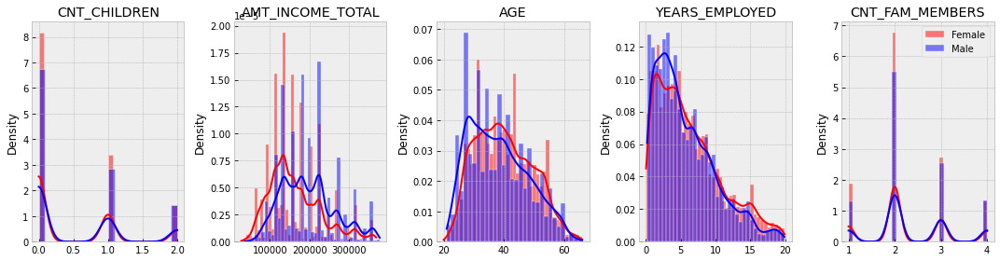

In [41]:
columns = 5
fig, axes = plt.subplots(len(Num_variables) // columns,
                         columns, squeeze=False, figsize=(15, 4))

F = merge_cleaned[merge_cleaned['CODE_GENDER'] == "F"]
M = merge_cleaned[merge_cleaned['CODE_GENDER'] == "M"]

for current_idx, variable in enumerate(Num_variables):
    i = current_idx // columns  # Filas
    j = current_idx % columns  # Columnas

    sns.histplot(F[variable], label='Female', ax=axes[i]
                 [j], stat="density", color="red", kde=True)
    sns.histplot(M[variable], label='Male', ax=axes[i]
                 [j], stat="density", color="blue", kde=True)

    axes[i][j].set_title(variable)
    axes[i][j].set_xlabel("")

plt.tight_layout()
plt.legend()
plt.show()


### Tiene impacto en la aprobación de TDC el nivel academico de los solicitantes?


In [42]:
record_approved = merge_cleaned["STATUS"] == 0
merge_record_approved = merge_cleaned[record_approved]
merge_record_approved


,ID,MONTHS_BALANCE,AMT_INCOME_TOTALxFamily member,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,...,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,YEARS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
2,5008806,0,56250.0,0,M,Y,Y,0,112500.0,Working,...,Married,House / apartment,58,3.106849,1,0,0,0,Security staff,2
11,5008819,-10,67500.0,0,M,Y,Y,0,135000.0,Commercial associate,...,Married,House / apartment,48,3.271233,1,0,0,0,Laborers,2
12,5008820,-8,67500.0,0,M,Y,Y,0,135000.0,Commercial associate,...,Married,House / apartment,48,3.271233,1,0,0,0,Laborers,2
13,5008821,0,67500.0,0,M,Y,Y,0,135000.0,Commercial associate,...,Married,House / apartment,48,3.271233,1,0,0,0,Laborers,2
14,5008822,-14,67500.0,0,M,Y,Y,0,135000.0,Commercial associate,...,Married,House / apartment,48,3.271233,1,0,0,0,Laborers,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36451,5150481,0,52500.0,0,F,Y,Y,1,157500.0,Working,...,Married,House / apartment,29,4.764384,1,0,0,0,Core staff,3
36452,5150482,-11,52500.0,0,F,Y,Y,1,157500.0,Working,...,Married,House / apartment,29,4.764384,1,0,0,0,Core staff,3
36453,5150483,0,52500.0,0,F,Y,Y,1,157500.0,Working,...,Married,House / apartment,29,4.764384,1,0,0,0,Core staff,3
36454,5150484,0,52500.0,0,F,Y,Y,1,157500.0,Working,...,Married,House / apartment,29,4.764384,1,0,0,0,Core staff,3


In [52]:
merge_record.groupby(["NAME_EDUCATION_TYPE"])["NAME_EDUCATION_TYPE"].count()

NAME_EDUCATION_TYPE
Academic degree                     32
Higher education                  9864
Incomplete higher                 1410
Lower secondary                    374
Secondary / secondary special    24777
Name: NAME_EDUCATION_TYPE, dtype: int64

In [46]:
# Dataframe record_EDUCATION_TOTAL
pd_application_record_EDUCATION = merge_cleaned.groupby(
    ["NAME_EDUCATION_TYPE"]).size().reset_index(name="COUNT")
pd_application_record_EDUCATION_percentage = pd_application_record_EDUCATION.assign(
    PERCETANGE=pd_application_record_EDUCATION[["COUNT"]] / len(merge_record)*100)
pd_application_record_EDUCATION_percentage


,NAME_EDUCATION_TYPE,COUNT,PERCETANGE
0,Academic degree,28,0.076803
1,Higher education,7184,19.705406
2,Incomplete higher,1154,3.165373
3,Lower secondary,197,0.540363
4,Secondary / secondary special,17156,47.058178


In [44]:
# Dataframe record_EDUCATION_APPROVED
pd_application_record_EDUCATION_APPROVED = merge_record_approved.groupby(
    ["NAME_EDUCATION_TYPE"]).size().reset_index(name="COUNT")
pd_application_record_EDUCATION_APPROVED_percentage = pd_application_record_EDUCATION_APPROVED.assign(
    PERCETANGE=pd_application_record_EDUCATION_APPROVED[["COUNT"]] / len(merge_record_approved)*100)
pd_application_record_EDUCATION_APPROVED_percentage


,NAME_EDUCATION_TYPE,COUNT,PERCETANGE
0,Academic degree,26,0.133306
1,Higher education,5535,28.378794
2,Incomplete higher,867,4.445242
3,Lower secondary,155,0.794709
4,Secondary / secondary special,12921,66.247949


In [86]:
# Subplot comparando Solicitados vs aprobados
fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'domain'}, {'type': 'domain'}]])

labels = list(
    pd_application_record_EDUCATION_percentage["NAME_EDUCATION_TYPE"])

fig.add_trace(go.Pie(labels=labels, values=list(pd_application_record_EDUCATION_percentage["COUNT"]), pull=[0.2, 0.2, 0.2, 0.2]), 1, 1,)

fig.add_trace(go.Pie(labels=labels, values=list(pd_application_record_EDUCATION_APPROVED_percentage["COUNT"]),  pull=[0.2, 0.2, 0.2, 0.2]),1, 2)

# Creando grafico tipo dona
fig.update_traces(hole=.65, hoverinfo="label", textinfo="value")
# fig.update_layout(width = 1400)

fig.update_layout(
    title_text="Nivel académico",
    # Sumando anotaciones
    annotations=[dict(text='Solicitantes', x=0.17, y=0.5, font_size=15, showarrow=False),
                 dict(text='Aprobados', x=0.83, y=0.5, font_size=15, showarrow=False)],
    width = 1000
    )


fig.show()

In [76]:
tipoEducacion = pd_application_record_EDUCATION_APPROVED_percentage["NAME_EDUCATION_TYPE"].values
porcentaje = pd_application_record_EDUCATION_APPROVED_percentage["COUNT"]/pd_application_record_EDUCATION_percentage["COUNT"]
dataFrame = {'NAME_EDUCATION_TYPE': tipoEducacion, 'PORCENTAJE': porcentaje}
pd.DataFrame(dataFrame)


,NAME_EDUCATION_TYPE,PORCENTAJE
0,Academic degree,0.928571
1,Higher education,0.770462
2,Incomplete higher,0.751300
3,Lower secondary,0.786802
4,Secondary / secondary special,0.753148


**Interpretación de los resultados**

Con respecto al total de los solicitantes y de quienes recibieron una tarjeta de crédito, se observa que mas de la mitad cuentan con la secundaria completa y mas de un cuarto cuenta con educaciòn superior culminada. Con lo cual mas del 95% cuentan nivel educativo alto o medio y no se observa incidencia del nivel educativo en el otorgamiento de dicha tarjeta. Dado que se mantiene las proporciones en ambas poblaciones. Con lo cual se demuestra que esta variable no impacta la aprobación de la TDC.
También considerar el porcentaje de aprobación para el título "Academic Degree" pero no se puede generar una conclusión porque los valores de la muestra son muy bajos.


## Análisis Bivariado


<Figure size 432x288 with 0 Axes>

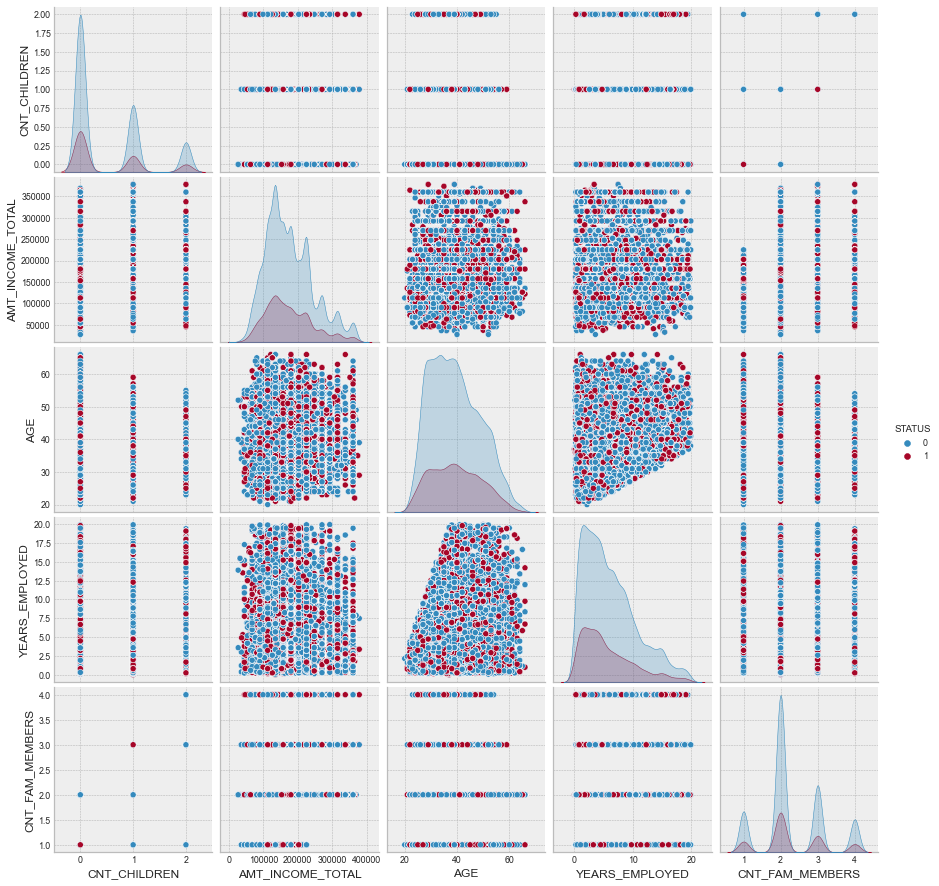

In [139]:
plt.figure()
Num_Gen_var = Num_variables.copy()
Num_Gen_var.append('STATUS')

sns.pairplot(merge_cleaned[Num_Gen_var], hue='STATUS',
             hue_order=[0, 1])  # ,palette = 'plasma')

plt.show()


### ¿Cual es la correlacion entre el estado civil de los clientes y la tasa de aprovacion de tarjetas de credito?


In [140]:
status_Family_Status_Join = pd.concat([merge_cleaned["NAME_FAMILY_STATUS"], merge_record["STATUS"]],
                                      axis=1)
countRows = status_Family_Status_Join.shape[0]
status_Family_Status_Join.index = np.arange(countRows)

mapped = status_Family_Status_Join.groupby(
    ["NAME_FAMILY_STATUS", "STATUS"]).size().reset_index(name="COUNT")
mapped.head()


,NAME_FAMILY_STATUS,STATUS,COUNT
0,Civil marriage,0,1857
1,Civil marriage,1,518
2,Married,0,13971
3,Married,1,4519
4,Separated,0,972


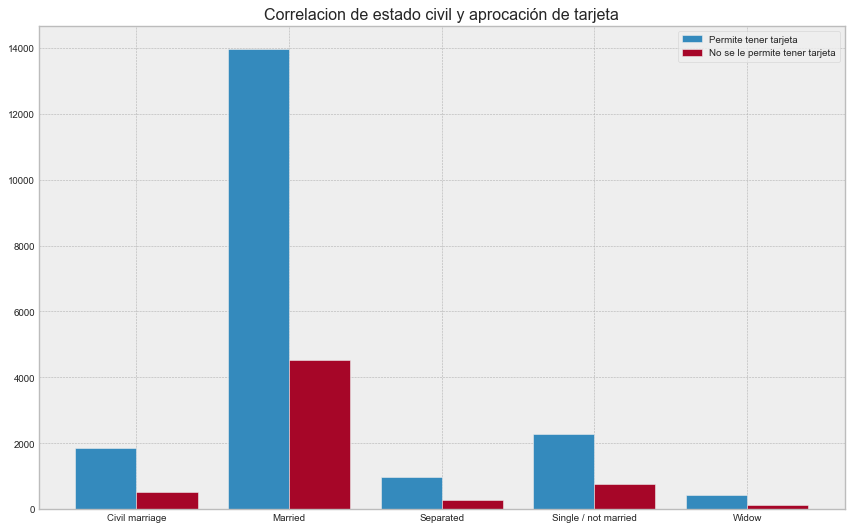

In [141]:
mappped_Pivoted = mapped.pivot(
    index="STATUS", columns="NAME_FAMILY_STATUS", values="COUNT")

status0 = []
status1 = []
columnsValues = mappped_Pivoted.columns.values
figure(figsize=(13, 8), dpi=80)

for valueSts in columnsValues:
    status0.append(mappped_Pivoted[valueSts][0])
    status1.append(mappped_Pivoted[valueSts][1])

x_axis = np.arange(len(columnsValues))

# Multi bar Chart

plt.bar(x_axis - 0.2, status0, width=0.4, label='Permite tener tarjeta')
plt.bar(x_axis + 0.2, status1, width=0.4,
        label='No se le permite tener tarjeta')

plt.xticks(x_axis, columnsValues)

# Add legend
plt.legend()

# Add title
plt.title("Correlacion de estado civil y aprocación de tarjeta")

# Modify Font
plt.rcParams.update({'font.size': 8})

# Display
plt.show()


**Interpretación de los resultados**

De este gráfico es posible interpretar que existe una gran afluencia de las personas que están casadas y que desean poseer una tarjeta de crédito; pero además no es posible concluir que existe alguna tendencia respecto al estado cívil de las personas que indique que se le otorgará con mayor probabilidad su tarjeta de crédito.


###¿Cual es la distribucion de las edades de los clientes que solicitan tarjetas de credito?


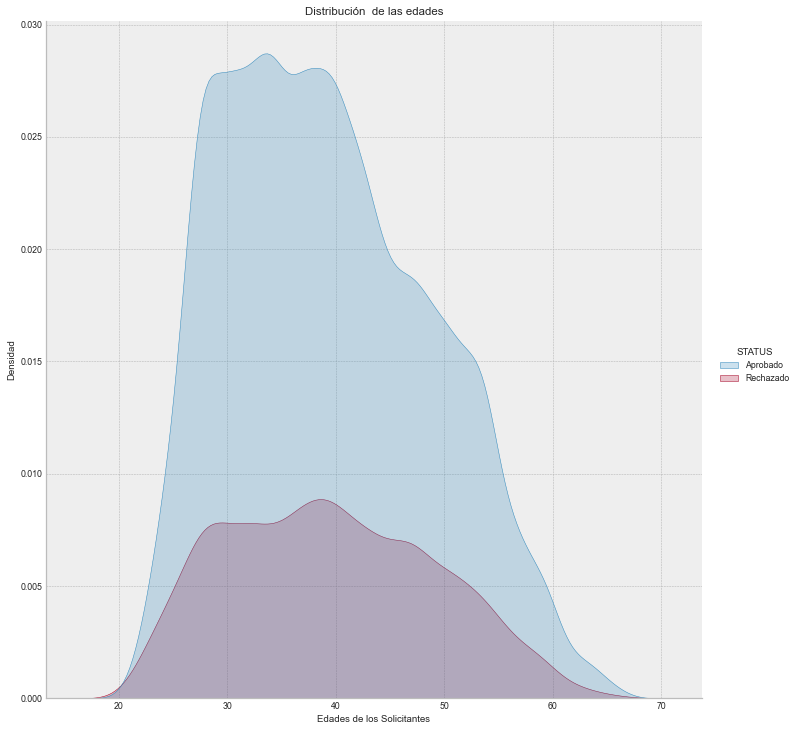

In [142]:
# Distribución de edad
merge_record_change_value_status = merge_cleaned.copy()
merge_record_change_value_status["STATUS"] = np.where(
    merge_record_change_value_status["STATUS"] == 0, "Aprobado", "Rechazado")
ax = sns.displot(data=merge_record_change_value_status, x='AGE',
                 kind='kde', hue='STATUS', fill=True, height=10)
ax.set(xlabel='Edades de los Solicitantes',
       ylabel='Densidad', title='Distribución  de las edades')


**Interpretación de los resultados**

La distribución de los aprobados es del tipo leptokurtica con inclinación negativa. En la misma se observa un pico entre la edades de 35 y 45 años. Por otro lado la distribución de los rechazados es del tipo mesokurtica. En conclusión la edad es un factor que indice en la aprobación de las TDC, siendo los mas jovenes quienes cuentan con mayor tasa de aprobación.


###¿cuales edades y sexos presentan mayores ingresos?


In [143]:
fig = px.histogram(merge_cleaned, x="AGE", y="AMT_INCOME_TOTAL", color="CODE_GENDER", marginal="box",
                   hover_data=merge_cleaned.columns)
fig.show()


**Interpretación de los resultados**

En general el nivel de ingreso de las mujeres es mayor que los hombres y en ambos sexos dicho nivel disminuye a medida que avanza la edad. Lo cual se relaciona con el grafico anterior, donde los mas jovenes cuentan con una mayor tasa de aprobacion.


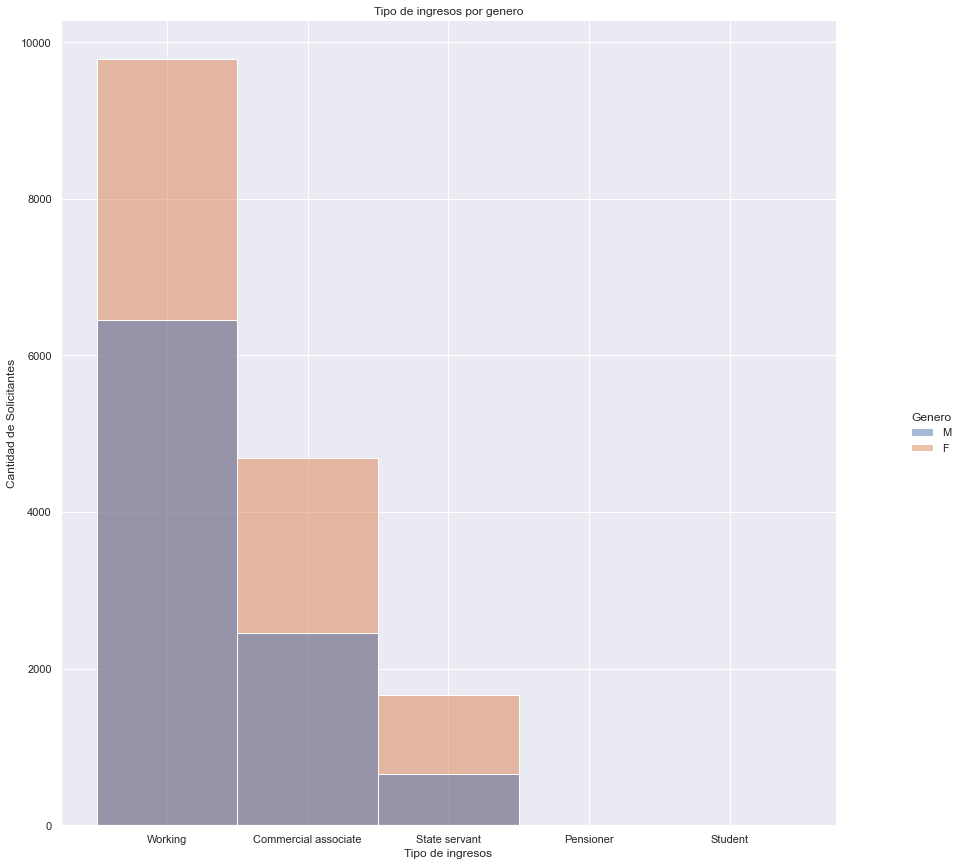

In [144]:
#  Grafico de ingresos
sns.set(font_scale=1)
ax = sns.displot(data=merge_cleaned, x="NAME_INCOME_TYPE",
                 hue="CODE_GENDER", height=12)
ax.set(xlabel='Tipo de ingresos', ylabel='Cantidad de Solicitantes',
       title="Tipo de ingresos por genero")
ax.legend.set_title("Genero")


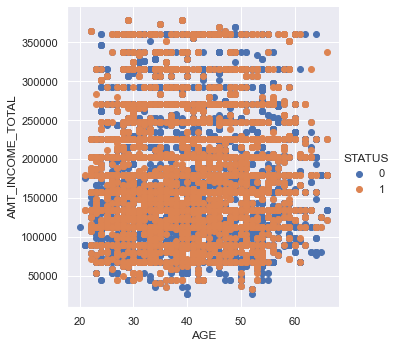

In [145]:
sns.FacetGrid(merge_cleaned, hue='STATUS', height=5).map(
    plt.scatter, 'AGE', 'AMT_INCOME_TOTAL').add_legend()
plt.show()


## Analisis Multivariado


### 1 - ¿Cuál es el nivel de correlación entre las variables?


In [146]:
corr_merge_record = merge_cleaned_normalice.copy()
merge_cleaned_normalice.corr()["STATUS"]


MONTHS_BALANCE                    0.108973
AMT_INCOME_TOTALxFamily member    0.005676
STATUS                            1.000000
CODE_GENDER                      -0.004718
FLAG_OWN_CAR                      0.010172
FLAG_OWN_REALTY                  -0.025758
CNT_CHILDREN                     -0.008741
AMT_INCOME_TOTAL                 -0.003468
NAME_INCOME_TYPE                 -0.009521
NAME_EDUCATION_TYPE               0.011216
NAME_FAMILY_STATUS                0.003670
NAME_HOUSING_TYPE                 0.004042
AGE                               0.012067
YEARS_EMPLOYED                   -0.035856
FLAG_MOBIL                             NaN
FLAG_WORK_PHONE                  -0.016932
FLAG_PHONE                       -0.006743
FLAG_EMAIL                        0.017049
OCCUPATION_TYPE                   0.001093
CNT_FAM_MEMBERS                  -0.006830
Name: STATUS, dtype: float64

Se procede a borrar datos con lo que no se trabajará


| Pearson’s r Value | Correlation Between x and y          |
| ----------------- | ------------------------------------ |
| equal to 1        | perfect positive linear relationship |
| greater than 0    | positive correlation                 |
| equal to 0        | no linear relationship               |
| less than 0       | negative correlation                 |
| equal to -1       | perfect negative linear relationship |


<AxesSubplot:>

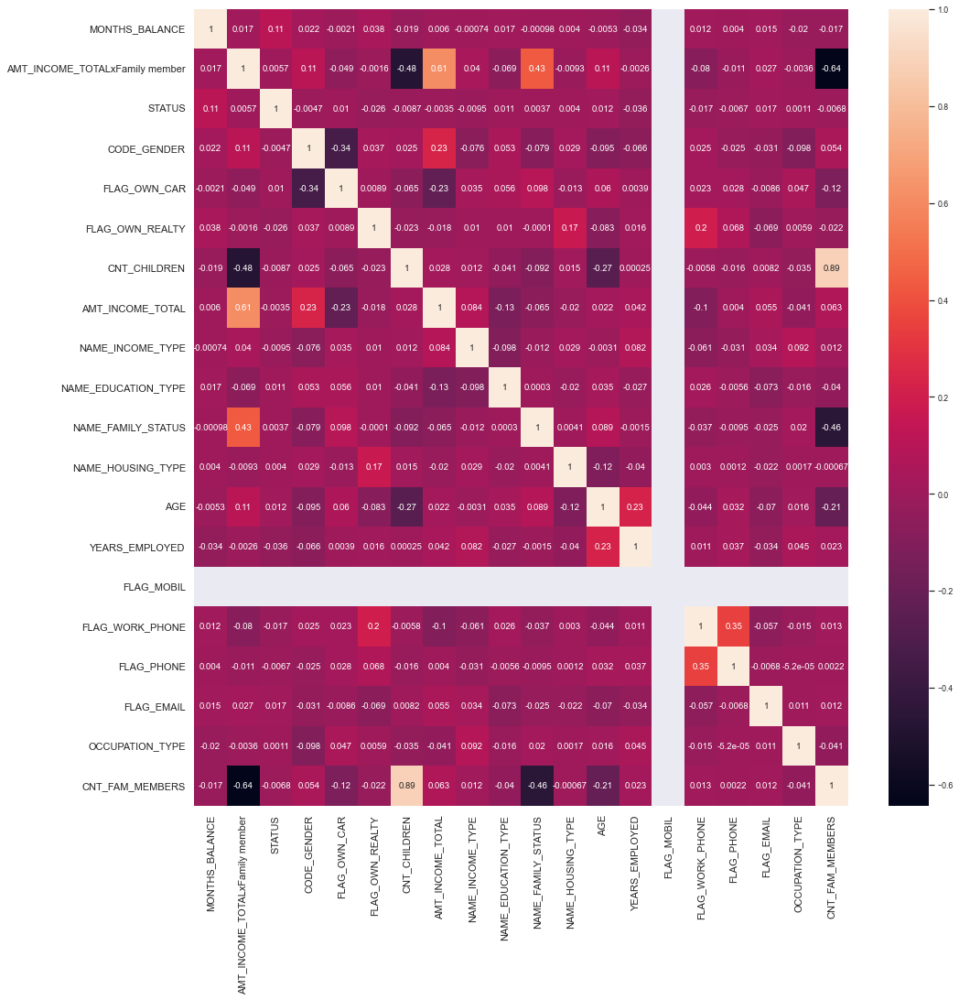

In [147]:
fig, ax = plt.subplots(figsize=(16, 16))
sns.set(font_scale=0.8)
sns.heatmap(corr_merge_record.corr(), annot=True)


#### Variables con mayor correlación con la variable dependiente

- CODE_GENDER
- FLAG_OWN_CAR
- FLAG_OWN_REALTY
- AMT_INCOME_TOTAL
- NAME_EDUCATION_TYPE
- NAME_HOUSING_TYPE
- FLAG_EMAIL


##### Conclusiones

1. Es posible apreciar que la mayor cantidad de personas que se les ha aprobado la tarjeta de crédito no poseen un vehículo personal. Junto a esto es posible verificar que el nivel educacional de las personas que se les aprobó la tarjeta fue: "Secondary / secondary special". Además que estaban casadas y poseían una casa o departamento propio.
2. Para el caso de la cantidad de hijos, la media ya la desviación estandar no nos estregan una correcta información, esto se debe a que logicamente no es posible tener un 0.5 hijos. Pero, si es posible comprobar que la mayor cantidad de personas que les otorgo una tarjeta de crédito no poseen hijos.
3. Para el caso de la desviación estandar relacionado al sueldo, se puede ver si que si existe una cercanía de los datos a esta, pero también existe una tendecia a alejarse de esta. Indicando que los datos, si tiene una tendencia a estar dispersos


In [148]:
dataFrameDecisionTree = corr_merge_record.copy()
dataFrameDecisionTree.drop(
    ["CNT_CHILDREN", "YEARS_EMPLOYED", "FLAG_WORK_PHONE", "FLAG_PHONE", "FLAG_MOBIL", "CNT_FAM_MEMBERS"], axis=1, inplace=True)

dataFrameDecisionTree.head()


,MONTHS_BALANCE,AMT_INCOME_TOTALxFamily member,STATUS,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,AGE,FLAG_EMAIL,OCCUPATION_TYPE
2,0,56250.0,0,1,0,0,112500.0,0,1,1,1,58,0,0
10,0,135000.0,1,1,0,0,270000.0,0,0,1,1,46,1,2
11,-10,67500.0,0,1,0,0,135000.0,1,1,1,1,48,0,3
12,-8,67500.0,0,1,0,0,135000.0,1,1,1,1,48,0,3
13,0,67500.0,0,1,0,0,135000.0,1,1,1,1,48,0,3


In [149]:
yTarget = dataFrameDecisionTree["STATUS"].values.astype('int')
X_train, X_test, y_train, y_test = train_test_split(dataFrameDecisionTree.drop(
    ['STATUS'], axis=1), yTarget, test_size=0.33, random_state=42)

tree_model = DecisionTreeClassifier(criterion='entropy',
                                    min_samples_split=20,
                                    min_samples_leaf=5,
                                    max_depth=8,
                                    class_weight={1: 7.5})
model = tree_model.fit(X_train, y_train)


In [150]:
%pip install dtreeviz


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [151]:
from dtreeviz.trees import dtreeviz
# Una forma diferente de ver el arbol
viz = dtreeviz(tree_model, X_train, yTarget,
               target_name="target",
               feature_names=X_train.columns,
               class_names=["Aprobado", "No Aprobado"])

viz


c:\Users\Marcelo Baeza\.pyenv\pyenv-win\versions\3.9.1\lib\site-packages\sklearn\base.py:450: UserWarning:

X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names



In [ ]:
# Realizo una predicción
y_train_pred = tree_model.predict(X_train)  # Prediccion en Train
y_test_pred = tree_model.predict(X_test)  # Prediccion en Test


In [ ]:
from sklearn.metrics import accuracy_score

# Calculo el accuracy en Train
train_accuracy = accuracy_score(y_train, y_train_pred)

# Calculo el accuracy en Test
test_accuracy = accuracy_score(y_test, y_test_pred)

print('% de aciertos sobre el set de entrenamiento:', train_accuracy)
print('% de aciertos sobre el set de evaluación:', test_accuracy)


In [ ]:

# X_train, X_test, y_train, y_test
confusionMatrixResult = confusion_matrix(y_test, y_test_pred)
ax = sns.heatmap(confusionMatrixResult, annot=True, cmap='Blues')

ax.set_title('Confusion Matrix\n\n')
ax.set_ylabel('\nPredicted Values')
ax.set_xlabel('Actual Values ')

# Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(['True', 'False'])
ax.yaxis.set_ticklabels(['True', 'False'])

# Display the visualization of the Confusion Matrix.
plt.show()
# plt.savefig('decisionTreePLT.png', dpi=1200)


In [ ]:
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred).ravel()
precision = tp/(tp+fp)
recall = tp/(tp+fn)
accuracy = (tp+tn)/(tn + fp + fn + tp)
especify = tn/(tn+fp)
f1_score = 2*(recall*precision)/(recall + precision)
print(precision, recall, especify, accuracy, f1_score)


---


# Comparación de Modelos de Machine Learning


In [ ]:
%pip install lightgbm


In [ ]:
%pip install xgboost


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import SGDClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from lightgbm import LGBMClassifier
# from xgboost.sklearn import XGBClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import time


## Cambiando tipo de datos


In [ ]:
dataToCompareModels = merge_cleaned_normalice.copy()
dataToCompareModels.head()


## Desglozando data


In [ ]:

cantiadadValores0, cantiadadValores1 = dataToCompareModels["STATUS"].value_counts(
)
X = dataToCompareModels.drop(['STATUS'], axis=1)
y = dataToCompareModels['STATUS']


## Operando con modelos


In [ ]:
! pip install mlxtend


### PCA


In [ ]:
standarScaler = StandardScaler()
X_train = standarScaler.fit_transform(X)
numeroColumnas = len(X.columns)
# por experiencia de pruebas partir desde el 10 la suma de la variancia era lejano al 90%
# se considera mejor desde el 14, donde la variancia es superior al 95%
listadoNumeroVariables_PCA = np.arange(14, numeroColumnas, 1)


#### Cross-Validations


In [ ]:
from sklearn.model_selection import cross_val_score, KFold, StratifiedKFold

seed = 123

# permite obtener una relación entre el status


def obtenerPesoPorStatus():
    if cantiadadValores0 > cantiadadValores1:
        return {1: cantiadadValores0/cantiadadValores1}
    else:
        return {1: cantiadadValores1/cantiadadValores0}


# Por experiencia y prueba los modelos que tuvieron que ser borrados por que tuvieron mal performance fueron:
    # LogisticRegression
    # SVC
    # GaussianNB
    # SGDClassifier
mejoresAlgoritmos = []
for numeroPCA in listadoNumeroVariables_PCA:
    pca = PCA(n_components=numeroPCA, random_state=123)
    xTrainFit = pca.fit_transform(X_train)
    # se borra por uso de redes neuronales
    #model4 = MLPClassifier(random_state=seed, max_iter=500)
    # se quiso añadir el knn pero no se suupo considerar
    model6 = {"objetoModelo": KNeighborsClassifier(
        weights='distance'), "nombreModelo": "KNeighborsClassifier"}
    model7 = {"objetoModelo": DecisionTreeClassifier(
        random_state=seed, max_depth=numeroPCA, class_weight=obtenerPesoPorStatus()), "nombreModelo": "DecisionTreeClassifier"}
    model8 = {"objetoModelo": RandomForestClassifier(
        random_state=seed, class_weight="balanced", n_estimators=200, max_depth=numeroPCA), "nombreModelo": "RandomForestClassifier"}
    model9 = {"objetoModelo": GradientBoostingClassifier(
        random_state=seed, max_depth=numeroPCA, learning_rate=200), "nombreModelo": "GradientBoostingClassifier"}
    model10 = {"objetoModelo": LGBMClassifier(random_state=seed, num_leaves=32, n_estimators=200,
                                              max_depth=numeroPCA, class_weight="balanced"), "nombreModelo": "LGBMClassifier"}
    models = [model6, model7, model8, model9, model10]
    print(f"{Colores.BLUE}Numero de PCA {Colores.RED}{numeroPCA}. {Colores.BLUE}Pca Variancia: {Colores.RED}{pca.explained_variance_ratio_} {Colores.GREEN}Suma:{pca.explained_variance_ratio_.sum()} {Colores.ENDC}")
    for model in models:
        start_time = time.time()
        cvKfold = StratifiedKFold(n_splits=10, random_state=seed, shuffle=True)
        # trabajando como medida con curva roc
        modelWork = model["objetoModelo"]
        scores = cross_val_score(modelWork, xTrainFit,
                                 y, scoring='roc_auc', cv=cvKfold, n_jobs=4)
        print(f"\t - {Colores.YELLOW}Modelo {modelWork} - {Colores.RED}{np.mean(scores)}. {Colores.YELLOW}Tiempo de ejecución {Colores.GREY}{(time.time() - start_time)} {Colores.ENDC}segundos.")
        mejoresAlgoritmos.append({
            "promedio": np.mean(scores),
            "modelo": model,
            "pca": pca,
            "xTrainFit": xTrainFit,
            "nombreModelo": model["nombreModelo"]
        })
    print("-----------------------------------------------------------")


In [ ]:
modelosOrdenados = list(
    sorted(mejoresAlgoritmos, key=lambda x: x["promedio"], reverse=True))


### Trabajando sobre los mejores promedios


In [ ]:
for i in [0, 1, 2]:
    nombreModelo = modelosOrdenados[i]["nombreModelo"]
    print(f"{i}. {nombreModelo}")


Se genera a partir de los splits de cross validations entrenamientos y predicciones de los modelos, con el fin de obtener una comparativa y porcentaje de relación entre los algoritmos de machine learning


#### Explicación algoritmo

1. Generando grid genéricos por indíce de modelos.
2. StratifieldKold, ya que permite trabajar con iguales etiquetas, que es necesario porque no existe igualdad entre estas dos
3. Se trabaja con la mejor selección de modelo: RandomizedSearchCV, ya que fue complicado en la experiencia trabajar con halving_random_search
4. Se trabaja con los 3 mejores modelos de la selección anterior.
5. Se registra el score de las ejecuciones (kfold) con el proposito de trabajar con las 3 mejores combinaciones.


In [ ]:
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import RandomizedSearchCV

kfold = 10
skf = StratifiedKFold(n_splits=kfold, shuffle=True, random_state=seed)

parametros_grid_generico = {
    "RandomForestClassifier": {
        "param_grid": {
            'max_depth': [14, 16, numeroColumnas],
            'n_estimators': [150, 200],
            'criterion': ['gini', 'entropy', 'log_loss'],
            "min_samples_split": [5, 10],
            'n_jobs': [4],
            'random_state': [int(seed/2), seed*2],
            'class_weight': ['balanced', 'balanced_subsample'],
            'bootstrap': [True, False]
        },
        "modelo": RandomForestClassifier()
    },
    "LGBMClassifier": {
        "param_grid": {
            'max_depth': [14, 16, numeroColumnas],
            'num_leaves': [31, 40],
            'learning_rate': [0.1, 0.2],
            'n_stimators': [150, 200],
            'class_weight': ['balanced', None],
            'min_child_weight': [1, 5],
            'random_state': [int(seed/2), seed*2],
            'n_jobs': [4]
        },
        "modelo": LGBMClassifier()
    }
}

score_best_params_ = []


def operandoMejoresModelos(modelosPromedio):

    # Valores para modelo 1
    X1 = np.array(modelosPromedio[0]['xTrainFit'])
    # Valores para modelo 2
    X2 = np.array(modelosPromedio[1]['xTrainFit'])
    # Valores para modelo 3
    X3 = np.array(modelosPromedio[2]['xTrainFit'])
    # for i, (dataOperacion1, dataOperacion2, dataOperacion3) in enumerate(zip(skf.split(X1, y1), skf.split(X2, y1), skf.split(X1, y1))):

    yGenerico = np.array(y)
    scores = []
    # for i, (train_index, test_index) in enumerate(skf.split(X1, y1)):
    for i, (dataOperacion1, dataOperacion2, dataOperacion3) in enumerate(zip(skf.split(X1, yGenerico), skf.split(X2, yGenerico), skf.split(X3, yGenerico))):
        print('[Fold %d/%d]' % (i + 1, kfold))
        start_time = time.time()

        # MODELO 1
        # Buscamos el modelo en los parametris grid
        if modelosPromedio[0]['nombreModelo'] not in parametros_grid_generico:
            raise SystemExit(
                f"Error no existe {modelosPromedio[0]['nombreModelo']}")

        #modelo1_ = modelosPromedio[0]['modelo']
        nombreModelo1 = modelosPromedio[0]['nombreModelo']
        modelo1_ = parametros_grid_generico[nombreModelo1]["modelo"]
        # print(f"{nombreModelo1 } {parametros_grid_generico[nombreModelo1]}")
        param_grid = parametros_grid_generico[nombreModelo1]["param_grid"]
        randomizedSearch_modelo1 = RandomizedSearchCV(
            modelo1_, param_grid, scoring="roc_auc", n_jobs=4)

        X_train1, X_valid1 = X1[dataOperacion1[0]], X1[dataOperacion1[1]]
        y_train1, y_valid_generico = yGenerico[dataOperacion1[0]
                                               ], yGenerico[dataOperacion1[1]]

        randomizedSearch_modelo1.fit(X_train1, y_train1)

        y_predic1 = pd.DataFrame(
            randomizedSearch_modelo1.predict_proba(X_valid1))[1].values

        # MODELO 2
        # Buscamos el modelo en los parametris grid
        if modelosPromedio[1]['nombreModelo'] not in parametros_grid_generico:
            raise SystemExit(
                f"Error no existe {modelosPromedio[1]['nombreModelo']}")

        # modelo2_ = modelosPromedio[1]['modelo']
        nombreModelo2 = modelosPromedio[1]['nombreModelo']
        modelo2_ = parametros_grid_generico[nombreModelo2]["modelo"]

        param_grid = parametros_grid_generico[nombreModelo2]["param_grid"]
        randomizedSearch_modelo2 = RandomizedSearchCV(
            modelo2_, param_grid, scoring="roc_auc", n_jobs=4)

        X_train2, X_valid2 = X2[dataOperacion2[0]], X2[dataOperacion2[1]]
        y_train2, y_valid_generico = yGenerico[dataOperacion2[0]
                                               ], yGenerico[dataOperacion2[1]]

        randomizedSearch_modelo2.fit(X_train2, y_train2)
        y_predic2 = pd.DataFrame(
            randomizedSearch_modelo2.predict_proba(X_valid2))[1].values

        # MODELO 3
        # Buscamos el modelo en los parametris grid
        if modelosPromedio[2]['nombreModelo'] not in parametros_grid_generico:
            raise SystemExit(
                f"Error no existe {modelosPromedio[2]['nombreModelo']}")

        # modelo3_ = modelosPromedio[2]['modelo']
        nombreModelo3 = modelosPromedio[2]['nombreModelo']
        modelo3_ = parametros_grid_generico[nombreModelo3]["modelo"]

        param_grid = parametros_grid_generico[nombreModelo3]["param_grid"]
        randomizedSearch_modelo3 = RandomizedSearchCV(
            modelo3_, param_grid, scoring="roc_auc", n_jobs=4)

        X_train3, X_valid3 = X3[dataOperacion3[0]], X3[dataOperacion3[1]]
        y_train3, y_valid_generico = yGenerico[dataOperacion3[0]
                                               ], yGenerico[dataOperacion3[1]]

        randomizedSearch_modelo3.fit(X_train3, y_train3)
        y_predic3 = pd.DataFrame(
            randomizedSearch_modelo3.predict_proba(X_valid3))[1].values

        y_pred = 0.60 * y_predic1 + 0.25 * y_predic2 + 0.15 * y_predic3

        score = roc_auc_score(y_valid_generico, y_pred)

        scores.append(score)
        score_best_params_.append({
            "score": score,
            "parametros_modelo_1": {
                "parametros": randomizedSearch_modelo1.best_params_,
                "modelo": randomizedSearch_modelo1.best_estimator_,
                "nombreModelo": nombreModelo1
            },
            "parametros_modelo_2": {
                "parametros": randomizedSearch_modelo2.best_params_,
                "modelo": randomizedSearch_modelo2.best_estimator_,
                "nombreModelo": nombreModelo2
            },
            "parametros_modelo_3": {
                "parametros": randomizedSearch_modelo3.best_params_,
                "modelo": randomizedSearch_modelo3.best_estimator_,
                "nombreModelo": nombreModelo3
            },
            "kfold": i+1
        })
        print(f"\t{Colores.YELLOW}Score: {score}. {Colores.BLUE}Tiempo ejecución {Colores.RED} {time.time() - start_time} {Colores.ENDC}segundos\n")
    print(f"Avg scores - {np.mean(scores)}")


operandoMejoresModelos(modelosOrdenados)


Se obtiene el mejor score junto a sus modelos correspondientes de la anterior prueba


In [ ]:
bestScore = list(
    sorted(score_best_params_, key=lambda x: x["score"], reverse=True))[0]


### Operando con los 3 modelos


Clasificación realizada para el data set completo.

Esto permite obtener la probabilidad que la se puede categorizar efectivamente.


In [ ]:
x_test_1 = np.array(modelosOrdenados[0]['xTrainFit'])
x_test_2 = np.array(modelosOrdenados[1]['xTrainFit'])
x_test_3 = np.array(modelosOrdenados[2]['xTrainFit'])
y_pred_test1 = pd.DataFrame(
    bestScore["parametros_modelo_1"]["modelo"].predict_proba(x_test_1))[1].values
y_pred_test2 = pd.DataFrame(
    bestScore["parametros_modelo_2"]["modelo"].predict_proba(x_test_2))[1].values
y_pred_test3 = pd.DataFrame(
    bestScore["parametros_modelo_3"]["modelo"].predict_proba(x_test_3))[1].values
y_pred_final = 0.65 * y_pred_test1 + 0.25 * y_pred_test2 + 0.10 * y_pred_test3


## Analizando resultados de algoritmos


In [ ]:
def describeNumpy(arrayIn):

    r1 = np.mean(arrayIn)
    print("Mean: ", r1)

    r2 = np.std(arrayIn)
    print("std: ", r2)

    r3 = np.var(arrayIn)
    print("Variance: ", r3)


### Predicción para el modelo 1


In [ ]:
describeNumpy(y_pred_test1)


### Predicción para el modelo 2


In [ ]:
describeNumpy(y_pred_test2)


### Predicción para el modelo 3


In [ ]:
describeNumpy(y_pred_test3)


In [ ]:
# sort_values( by=["STATUS"], ascending=False)
submission = pd.DataFrame({'STATUS': y_pred_final})
submission.describe()


## Conclusiones


- Es posible apreciar que en comparativa de los podemos existen 3 que resalta a la hora de efectuar una correcta categorización.

- En los 3 de los modelos existe una baja desviación estandar, permitiendo entender que no existe una gran dispersión de los datos, por lo que los modelos clasificaron de una manera uniforme, sin tanta diferencia.

- A pesar de poseer una desviación estandar el promedio de categorización es bajo. Por lo que la probablidad de etiquetar correctamente será baja

- Respecto a la probabilidad promediada de donde se presenta anteriormente, la probabilidad mínima es muy baja para considerar en un futuro, y el 75% supera el 13% lo cual sigue siendo bajo. Pero se mantiene la desviación estable.

---

##### Actualización post Model Selection

- En base a la experiencia operada, se observa que el promedio de los 3 algoritmos aumenta.
- La desviación standar fue baja todavía.
- La probabilidad de categorización correctamente, sigue siendo baja.
- Es grato (pero poco objetivo jeje) ver que se obtuvo un maximo de 91% para la categorización y que el 75% supera el 53%.


# Bias-Variance Trade Off


In [ ]:
from mlxtend.evaluate import bias_variance_decomp
########################
#BIAS-VARIANCE TRADEOFF#
########################


def calculandoBiasVariance(randomModelo, nombreModelo, parametros, X_train, y_train, X_test, y_test):
    print(f"{Colores.BLUE} BIAS-VARIANCE - TRADE-OFF : {Colores.GREEN}{nombreModelo}")
    print(f"{Colores.PINK} Parametría: {parametros}")
    inicio = time.time()
    mse, bias, var = bias_variance_decomp(
        randomModelo, X_train, y_train, X_test, y_test, loss='mse', num_rounds=100, random_seed=seed)
    print(f"\t{Colores.RED}Tiempo {time.time()-inicio} segundos.{Colores.ENDC}")
    print(f"\tMSE: {mse:.3f}")
    print(f"\tBias: {bias:.3f}")
    print(f"\tVariance: {var:.3f}")


In [ ]:
# MODELO 1
y = dataToCompareModels['STATUS']
yArray = np.array(y)
x_test_1 = np.array(modelosOrdenados[0]['xTrainFit'])
X_train, X_test, y_train, y_test = train_test_split(
    x_test_1, yArray, test_size=0.3, random_state=1)
modelo = bestScore["parametros_modelo_1"]["modelo"]
nombreModelo = bestScore["parametros_modelo_1"]["nombreModelo"]
parametros = bestScore["parametros_modelo_1"]["parametros"]
calculandoBiasVariance(modelo, nombreModelo, parametros,
                       X_train, y_train, X_test, y_test)

# MODELO 2
x_test_2 = np.array(modelosOrdenados[1]['xTrainFit'])
X_train, X_test, y_train, y_test = train_test_split(
    x_test_2, yArray, test_size=0.33, random_state=1)
modelo = bestScore["parametros_modelo_2"]["modelo"]
nombreModelo = bestScore["parametros_modelo_2"]["nombreModelo"]
parametros = bestScore["parametros_modelo_2"]["parametros"]
calculandoBiasVariance(modelo, nombreModelo, parametros,
                       X_train, y_train, X_test, y_test)

# MODELO 3
x_test_3 = np.array(modelosOrdenados[2]['xTrainFit'])
X_train, X_test, y_train, y_test = train_test_split(
    x_test_3, yArray, test_size=0.33, random_state=1)
modelo = bestScore["parametros_modelo_3"]["modelo"]
nombreModelo = bestScore["parametros_modelo_3"]["nombreModelo"]
parametros = bestScore["parametros_modelo_3"]["parametros"]
calculandoBiasVariance(modelo, nombreModelo, parametros,
                       X_train, y_train, X_test, y_test)


### Conclusiones

1. Para los 3 modelos RandomForest con aspectos de clasificación poseen una varianza baja, permitiendo entender que el modelo posee una buena robustes en cuando a que aunque cambien los datos de entrenamientos no existirán cambios pequeños en la estimación.
2. Para el caso del bias, presentamos en los 3 casos un valor bajo, por lo que posee un gran sesgo entre el valor esperado y la probabilidad de obtenerlo.
3. Al tener tanto la varianza y el bias tenemos un modelo robusto:

![Lo óptimo que queremos tener, es un modelo que tenga poco bias y poca varianza. Esto es lo que se llamaría un modelo robusto.!](Screenshot_2.png "TradeOff Bias vs Variance")

Encontrando el balance perfecto
Un modelo predictivo bueno será el que tenga un buen balance entre bias y varianza de manera que se minimice el error total:
$Error Total = Bias^2 + Varianza + Error Irreducible$

![Lo óptimo que queremos tener, es un modelo que tenga poco bias y poca varianza. Esto es lo que se llamaría un modelo robusto.!](Screenshot_1.png "Balance perfecto")

4. sdfds
